In [1]:
import sys; sys.path.insert(0, '../'); from lib import *
import plotly.offline as py
from scipy.ndimage.interpolation import shift

You have latex installed!. Applying default configuration (tex=True)


/tmp/ipykernel_9242/3932072231.py:3: DeprecationWarning:

Please use `shift` from the `scipy.ndimage` namespace, the `scipy.ndimage.interpolation` namespace is deprecated.



# SBND_XA_VIS day 1
 - Alpha runes: 4 - 12
 - Muones: 13
 - Laser: 14 - 19
 - Ruido: 20 - 22

In [8]:
info = read_input_file("SBND_XA_VIS_day1")

runs = np.asarray(info["ALPHA_RUNS"]).astype(int)
chs = np.asarray(info["CHAN_TOTAL"]).astype(int)

my_runs = load_npy(runs,chs,preset="EVA",info=info,compressed=True)  # Select runs to be deconvolved (tipichaly alpha)



dict_keys(['DAQ', 'MODEL', 'BITS', 'DYNAMIC_RANGE', 'SAMPLING', 'RAW_DATA', 'PATH', 'MONTH', 'OV_LABEL', 'MUONS_RUNS', 'LIGHT_RUNS', 'ALPHA_RUNS', 'CALIB_RUNS', 'CHAN_LABEL', 'CHAN_TOTAL', 'CHAN_POLAR', 'CHAN_AMPLI', 'LOAD_PRESET', 'SAVE_PRESET', 'TYPE', 'REF', 'I_RANGE', 'F_RANGE'])


-> DONE!

-> DONE!

-> DONE!

-> DONE!

-> DONE!

-> DONE!

-> DONE!

-> DONE!

-> DONE!

-> DONE!

-> DONE!

-> DONE!



In [9]:
parameters = {
"sigma":    1e-8,
"a_fast":   1e-8,
"a_slow":   1e-8,
"tau_slow": 0.8e-6}
ranges = [50, 600]
out, potp = fit_wvfs(my_runs,"Scint",thrld=1e-6,fit_range=[ranges[0],ranges[1]],i_param=parameters,in_key=["GaussAveWvf"],
                     OPT={"SHOW": False, "TERMINAL_OUTPUT": True})
# print(out)
# print(potp)


--- FISRT FIT VALUES (FAST) ---
TIME:	3.84E-06	2.35E-10
SIGM:	1.52E-08	1.52E-10
AMP1:	1.15E-08	4.56E-11
TAU1:	1.28E-08	3.57E-10
-------------------------------
Fitting wvf 0 for run 6, ch 0

---------- TOTAL FIT ----------
PED:	2.28E-05	3.13E-05
T0:	3.84E-06	2.35E-10
SIG1:	1.52E-08	1.52E-10
AMP1:	1.37E-08	1.11E-09
TAU1:	1.15E-08	4.56E-11
SIG2:	1.08E-12	2.68E-05
AMP2:	1.84E-09	4.94E-11
TAU2:	6.62E-07	1.34E-08
--------------------------------


--- FISRT FIT VALUES (FAST) ---
TIME:	3.84E-06	2.42E-10
SIGM:	1.53E-08	1.57E-10
AMP1:	1.17E-08	4.72E-11
TAU1:	1.30E-08	3.68E-10
-------------------------------
Fitting wvf 0 for run 6, ch 1

---------- TOTAL FIT ----------
PED:	1.94E-05	2.63E-05
T0:	3.84E-06	2.42E-10
SIG1:	1.53E-08	1.57E-10
AMP1:	1.35E-08	INF
TAU1:	1.17E-08	4.72E-11
SIG2:	3.16E-13	INF
AMP2:	1.85E-09	INF
TAU2:	6.51E-07	INF
--------------------------------


--- FISRT FIT VALUES (FAST) ---
TIME:	3.84E-06	2.26E-10
SIGM:	1.53E-08	1.44E-10
AMP1:	1.16E-08	4.31E-11
TAU1:	1.28E-08	3.41E-

/home/andres/CYTHON_TOOLS/notebooks/../lib/fit_functions.py:56: RuntimeWarning:

invalid value encountered in log

/home/andres/.local/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:881: OptimizeWarning:

Covariance of the parameters could not be estimated



In [107]:
keys = ["GaussAveWvf","FitScint"]
time = []
wvfs = []
pd_runs = []
pd_chs = []
pd_keys = []
for run, ch, key in product(runs, chs, keys):
    time = np.append(time,my_runs[run][ch]["Sampling"]*np.arange(len(my_runs[run][ch][key][0])))
    wvfs = np.append(wvfs,my_runs[run][ch][key][0])
    pd_runs = np.append(pd_runs,len(my_runs[run][ch][key][0])*[run])
    pd_chs = np.append(pd_chs,len(my_runs[run][ch][key][0])*[ch])
    pd_keys = np.append(pd_keys,len(my_runs[run][ch][key][0])*[key])

In [108]:
df = pd.DataFrame({"TIME":time,"WVF":wvfs,"RUNS":pd_runs,"CHANNELS":pd_chs,"KEYS":pd_keys})
fig = px.line(df, x="TIME", y="WVF", facet_row="RUNS", facet_col="CHANNELS", color="KEYS", log_y=True, height=1000)
fit_range_idx = np.argmax(my_runs[runs[0]][chs[0]]["GaussAveWvf"][0])+ranges[1]
fig.add_vline(x= fit_range_idx*my_runs[runs[0]][chs[0]]["Sampling"], line_width=2, line_dash="dash", line_color="salmon")
fig.show()

# SBND_XA_VIS day2
 - Alpha runes: 27 - 35
 - Muones: 36

In [109]:
info = read_input_file("SBND_XA_VIS_day2")

runs = np.asarray(info["ALPHA_RUNS"]).astype(int)
chs = np.asarray(info["CHAN_TOTAL"]).astype(int)

my_runs = load_npy(runs,chs,preset="EVA",info=info,compressed=True)  # Select runs to be deconvolved (tipichaly alpha)



dict_keys(['DAQ', 'MODEL', 'BITS', 'DYNAMIC_RANGE', 'SAMPLING', 'RAW_DATA', 'PATH', 'MONTH', 'OV_LABEL', 'MUONS_RUNS', 'LIGHT_RUNS', 'ALPHA_RUNS', 'CALIB_RUNS', 'CHAN_LABEL', 'CHAN_TOTAL', 'CHAN_POLAR', 'CHAN_AMPLI', 'LOAD_PRESET', 'SAVE_PRESET', 'TYPE', 'REF', 'I_RANGE', 'F_RANGE'])


-> DONE!

-> DONE!

-> DONE!

-> DONE!

-> DONE!

-> DONE!

-> DONE!

-> DONE!

-> DONE!

-> DONE!

-> DONE!

-> DONE!



In [110]:
parameters = {
"sigma":    1e-8,
"a_fast":   1e-8,
"a_slow":   1e-7,
"tau_slow": 0.2e-6}
ranges = [50, 250]
out, potp = fit_wvfs(my_runs,"Scint",thrld=1e-6,fit_range=[ranges[0],ranges[1]],i_param=parameters,in_key=["GaussAveWvf"],
                     OPT={"SHOW": False, "TERMINAL_OUTPUT": True})
# print(out)
# print(potp)


--- FISRT FIT VALUES (FAST) ---
TIME:	3.84E-06	2.45E-10
SIGM:	1.54E-08	1.56E-10
AMP1:	1.17E-08	4.66E-11
TAU1:	1.27E-08	3.69E-10
-------------------------------
Fitting wvf 0 for run 29, ch 0

---------- TOTAL FIT ----------
PED:	2.73E-05	3.84E-05
T0:	3.84E-06	2.45E-10
SIG1:	1.54E-08	1.56E-10
AMP1:	1.32E-08	1.06E-09
TAU1:	1.17E-08	4.66E-11
SIG2:	3.71E-11	3.34E-05
AMP2:	1.06E-09	5.68E-11
TAU2:	2.31E-07	6.42E-09
--------------------------------


--- FISRT FIT VALUES (FAST) ---
TIME:	3.84E-06	2.46E-10
SIGM:	1.54E-08	1.58E-10
AMP1:	1.17E-08	4.74E-11
TAU1:	1.29E-08	3.72E-10
-------------------------------
Fitting wvf 0 for run 29, ch 1

---------- TOTAL FIT ----------
PED:	2.80E-05	3.76E-05
T0:	3.84E-06	2.46E-10
SIG1:	1.54E-08	1.58E-10
AMP1:	1.31E-08	1.76E-09
TAU1:	1.17E-08	4.74E-11
SIG2:	8.85E-12	6.25E-05
AMP2:	1.08E-09	9.25E-11
TAU2:	2.19E-07	9.81E-09
--------------------------------


--- FISRT FIT VALUES (FAST) ---
TIME:	3.84E-06	2.27E-10
SIGM:	1.55E-08	1.44E-10
AMP1:	1.17E-08	4.27E-11

/home/andres/CYTHON_TOOLS/notebooks/../lib/fit_functions.py:56: RuntimeWarning:

invalid value encountered in log



In [111]:
keys = ["GaussAveWvf","FitScint"]
time = []
wvfs = []
pd_runs = []
pd_chs = []
pd_keys = []
for run, ch, key in product(runs, chs, keys):
    time = np.append(time,my_runs[run][ch]["Sampling"]*np.arange(len(my_runs[run][ch][key][0])))
    wvfs = np.append(wvfs,my_runs[run][ch][key][0])
    pd_runs = np.append(pd_runs,len(my_runs[run][ch][key][0])*[run])
    pd_chs = np.append(pd_chs,len(my_runs[run][ch][key][0])*[ch])
    pd_keys = np.append(pd_keys,len(my_runs[run][ch][key][0])*[key])

In [112]:
df = pd.DataFrame({"TIME":time,"WVF":wvfs,"RUNS":pd_runs,"CHANNELS":pd_chs,"KEYS":pd_keys})
fig = px.line(df, x="TIME", y="WVF", facet_row="RUNS", facet_col="CHANNELS", color="KEYS", log_y=True, height=1000)
fit_range_idx = np.argmax(my_runs[runs[0]][chs[0]]["GaussAveWvf"][0])+ranges[1]
fig.add_vline(x= fit_range_idx*my_runs[runs[0]][chs[0]]["Sampling"], line_width=2, line_dash="dash", line_color="salmon")
fig.show()

    Run  Ch           Tau     PE
0     6   0  6.620000e-07  15.40
1     6   1  6.510000e-07  15.70
2     6   3  6.330000e-07  13.00
3     6   4  6.290000e-07  14.20
4     9   0  6.300000e-07  15.40
5     9   1  6.420000e-07  15.60
6     9   3  6.240000e-07  13.20
7     9   4  6.290000e-07  14.40
8    12   0  5.840000e-07  15.07
9    12   1  5.610000e-07  15.35
10   12   3  5.610000e-07  12.80
11   12   4  5.480000e-07  13.87


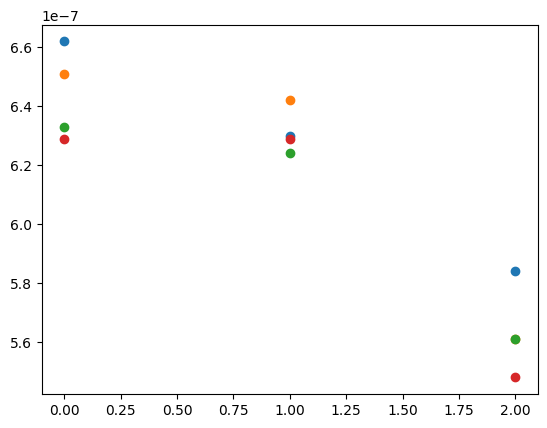

In [14]:
data = pd.read_csv("../fit_data/taus.txt",header = 0, sep = "\t")
print(data)
tau_ch0 = data["Tau"][data["Ch"]==0]
tau_ch1 = data["Tau"][data["Ch"]==1]
tau_ch3 = data["Tau"][data["Ch"]==3]
tau_ch4 = data["Tau"][data["Ch"]==4]
time = range(0,len(tau_ch0))
plt.scatter(time, [tau_ch0])
plt.scatter(time, [tau_ch1])
plt.scatter(time, [tau_ch3])
plt.scatter(time, [tau_ch4])
plt.show()

# SBND_XA_VUV - Apsaia day 1
 - Alpha runes: 1,2, 6 - 9
 - Muones: 10
 - Calibracion: 3 - 5

In [2]:
info = read_input_file("SBND_XA_VUV_day1")

runs = np.asarray(info["ALPHA_RUNS"]).astype(int)
chs = np.asarray(info["CHAN_TOTAL"]).astype(int)

my_runs = load_npy(runs,chs,preset="EVA",info=info,compressed=True)  # Select runs to be deconvolved (tipichaly alpha)



dict_keys(['DAQ', 'MODEL', 'BITS', 'DYNAMIC_RANGE', 'SAMPLING', 'RAW_DATA', 'PATH', 'MONTH', 'OV_LABEL', 'MUONS_RUNS', 'LIGHT_RUNS', 'ALPHA_RUNS', 'CALIB_RUNS', 'CHAN_LABEL', 'CHAN_TOTAL', 'CHAN_POLAR', 'CHAN_AMPLI', 'LOAD_PRESET', 'SAVE_PRESET', 'TYPE', 'REF', 'I_RANGE', 'F_RANGE'])


-> DONE!

-> DONE!

-> DONE!

-> DONE!

-> DONE!

-> DONE!

-> DONE!

-> DONE!

-> DONE!

-> DONE!

-> DONE!

-> DONE!

-> DONE!

-> DONE!

-> DONE!



In [3]:
parameters = {
"sigma":    1e-8,
"a_fast":   1e-8,
"a_slow":   1e-8,
"tau_slow": 0.6e-6}
ranges = [50, 350]
out, potp = fit_wvfs(my_runs,"SimpleScint",thrld=1e-6,fit_range=[ranges[0],ranges[1]],i_param=parameters,in_key=["GaussAveWvf"],
                     OPT={"SHOW": False, "TERMINAL_OUTPUT": True})
# print(out)
# print(potp)

Fitting wvf 0 for run 2, ch 0

---------- TOTAL FIT ----------
CONST:	6.10E-09	2.50E-03
AMP1:	-1.03E+00	8.36E+05
TAU1:	1.92E+00	7.97E+05
TAU2:	2.17E-08	3.44E-10
--------------------------------

Fitting wvf 0 for run 2, ch 1

---------- TOTAL FIT ----------
CONST:	1.36E-08	6.85E-04
AMP1:	5.29E-02	4.77E+04
TAU1:	-2.41E-01	2.31E+05
TAU2:	2.23E-08	3.53E-10
--------------------------------

Fitting wvf 0 for run 2, ch 3

---------- TOTAL FIT ----------
CONST:	1.50E-08	1.44E-03
AMP1:	7.11E-02	8.88E+04
TAU1:	-2.34E-01	3.13E+05
TAU2:	2.35E-08	4.17E-10
--------------------------------

Fitting wvf 0 for run 2, ch 4

---------- TOTAL FIT ----------
CONST:	1.62E-08	3.31E-03
AMP1:	1.31E-01	1.77E+05
TAU1:	-1.85E-01	2.82E+05
TAU2:	2.36E-08	4.32E-10
--------------------------------

Fitting wvf 0 for run 2, ch 5

---------- TOTAL FIT ----------
CONST:	1.62E-08	1.61E-03
AMP1:	5.37E-02	9.40E+04
TAU1:	-2.39E-01	4.35E+05
TAU2:	2.57E-08	5.37E-10
--------------------------------

Fitting wvf 0 for run 7, 

In [25]:
parameters = {
"const": 1e-8,
"a_fast":   0.95,
"tau_fast":   2e-8,
"tau_slow": 0.2e-6}
ranges = [0,350]
out, potp = fit_wvfs(my_runs,"SimpleScint",thrld=1e-6,fit_range=[ranges[0],ranges[1]],i_param=parameters,in_key=["GaussAveWvf"],
                     OPT={"SHOW": False, "TERMINAL_OUTPUT": True})
# print(out)
# print(potp)

Fitting wvf 0 for run 2, ch 0

---------- TOTAL FIT ----------
CONST:	1.36E-08	9.14E-10
AMP1:	9.08E-01	5.91E-02
TAU1:	2.16E-08	3.00E-10
TAU2:	6.48E-07	7.88E-07
--------------------------------

Fitting wvf 0 for run 2, ch 1

---------- TOTAL FIT ----------
CONST:	1.44E-08	1.64E-09
AMP1:	8.83E-01	9.74E-02
TAU1:	2.20E-08	3.01E-10
TAU2:	1.02E-06	1.58E-06
--------------------------------

Fitting wvf 0 for run 2, ch 3

---------- TOTAL FIT ----------
CONST:	1.49E-08	1.09E-09
AMP1:	8.90E-01	6.31E-02
TAU1:	2.20E-08	3.61E-10
TAU2:	6.05E-07	6.74E-07
--------------------------------

Fitting wvf 0 for run 2, ch 4

---------- TOTAL FIT ----------
CONST:	1.50E-08	1.13E-09
AMP1:	8.89E-01	6.48E-02
TAU1:	2.20E-08	3.68E-10
TAU2:	6.10E-07	6.94E-07
--------------------------------

Fitting wvf 0 for run 2, ch 5

---------- TOTAL FIT ----------
CONST:	1.47E-08	4.12E-10
AMP1:	8.55E-01	2.41E-01
TAU1:	2.20E-08	1.82E-09
TAU2:	4.50E-08	5.09E-08
--------------------------------

Fitting wvf 0 for run 7, ch 0


In [26]:
keys = ["GaussAveWvf","FitSimpleScint"]
time = []
wvfs = []
pd_runs = []
pd_chs = []
pd_keys = []
for run, ch, key in product(runs, chs, keys):
    time = np.append(time,my_runs[run][ch]["Sampling"]*np.arange(len(my_runs[run][ch][key][0])))
    wvfs = np.append(wvfs,my_runs[run][ch][key][0])
    pd_runs = np.append(pd_runs,len(my_runs[run][ch][key][0])*[run])
    pd_chs = np.append(pd_chs,len(my_runs[run][ch][key][0])*[ch])
    pd_keys = np.append(pd_keys,len(my_runs[run][ch][key][0])*[key])

In [27]:
df = pd.DataFrame({"TIME":time,"WVF":wvfs,"RUNS":pd_runs,"CHANNELS":pd_chs,"KEYS":pd_keys})
fig = px.line(df, x="TIME", y="WVF", facet_row="RUNS", facet_col="CHANNELS", color="KEYS", log_y=True, height=750)
fit_range_idx = np.argmax(my_runs[runs[0]][chs[0]]["GaussAveWvf"][0])+ranges[1]
fig.add_vline(x= fit_range_idx*my_runs[runs[0]][chs[0]]["Sampling"], line_width=2, line_dash="dash", line_color="salmon")
fig.show()

# SBND_XA_VUV - Apsaia day 2
 - Alpha runes: 11 - 16
 - Muones: 10
 - Calibracion: 3 - 5

In [4]:
info = read_input_file("SBND_XA_VUV_day2")

runs = np.asarray(info["ALPHA_RUNS"]).astype(int)
chs = np.asarray(info["CHAN_TOTAL"]).astype(int)

my_runs = load_npy(runs,chs,preset="EVA",info=info,compressed=True)  # Select runs to be deconvolved (tipichaly alpha)



dict_keys(['DAQ', 'MODEL', 'BITS', 'DYNAMIC_RANGE', 'SAMPLING', 'RAW_DATA', 'PATH', 'MONTH', 'OV_LABEL', 'MUONS_RUNS', 'LIGHT_RUNS', 'ALPHA_RUNS', 'CALIB_RUNS', 'CHAN_LABEL', 'CHAN_TOTAL', 'CHAN_POLAR', 'CHAN_AMPLI', 'LOAD_PRESET', 'SAVE_PRESET', 'TYPE', 'REF', 'I_RANGE', 'F_RANGE'])


-> DONE!

-> DONE!

-> DONE!

-> DONE!

-> DONE!

-> DONE!

-> DONE!

-> DONE!

-> DONE!

-> DONE!

-> DONE!

-> DONE!

-> DONE!

-> DONE!

-> DONE!



In [26]:
parameters = {
"sigma":    1e-8,
"a_fast":   1e-8,
"a_slow":   1e-8,
"tau_slow": 0.6e-6}
ranges = [50, 300]
out, potp = fit_wvfs(my_runs,"Scint",thrld=1e-6,fit_range=[ranges[0],ranges[1]],i_param=parameters,in_key=["GaussAveWvf"],
                     OPT={"SHOW": False, "TERMINAL_OUTPUT": True})
# print(out)
# print(potp)


--- FISRT FIT VALUES (FAST) ---
TIME:	3.87E-06	4.79E-10
SIGM:	1.85E-08	2.75E-10
AMP1:	1.35E-08	7.68E-11
TAU1:	1.32E-08	6.79E-10
-------------------------------
Fitting wvf 0 for run 3, ch 5

---------- TOTAL FIT ----------
PED:	3.05E-05	8.38E-05
T0:	3.87E-06	4.79E-10
SIG1:	1.85E-08	2.75E-10
AMP1:	1.98E-08	INF
TAU1:	1.35E-08	7.68E-11
SIG2:	4.09E-12	INF
AMP2:	3.34E-09	INF
TAU2:	6.91E-07	INF
--------------------------------





/home/andres/CYTHON_TOOLS/notebooks/../lib/fit_functions.py:56: RuntimeWarning:

invalid value encountered in log

/home/andres/.local/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:881: OptimizeWarning:

Covariance of the parameters could not be estimated



In [13]:
keys = ["GaussAveWvf","FitScint"]
time = []
wvfs = []
pd_runs = []
pd_chs = []
pd_keys = []
for run, ch, key in product(runs, chs, keys):
    time = np.append(time,my_runs[run][ch]["Sampling"]*np.arange(len(my_runs[run][ch][key][0])))
    wvfs = np.append(wvfs,my_runs[run][ch][key][0])
    pd_runs = np.append(pd_runs,len(my_runs[run][ch][key][0])*[run])
    pd_chs = np.append(pd_chs,len(my_runs[run][ch][key][0])*[ch])
    pd_keys = np.append(pd_keys,len(my_runs[run][ch][key][0])*[key])

In [14]:
df = pd.DataFrame({"TIME":time,"WVF":wvfs,"RUNS":pd_runs,"CHANNELS":pd_chs,"KEYS":pd_keys})
fig = px.line(df, x="TIME", y="WVF", facet_row="RUNS", facet_col="CHANNELS", color="KEYS", log_y=True, height=700)
fit_range_idx = np.argmax(my_runs[runs[0]][chs[0]]["GaussAveWvf"][0])+ranges[1]
fig.add_vline(x= fit_range_idx*my_runs[runs[0]][chs[0]]["Sampling"], line_width=2, line_dash="dash", line_color="salmon")
fig.show()

# SBND_XA_VIS_DAPHNE 
 - Alpha runes: 4 - 12
 - Muones: 13
 - Laser: 14 - 19
 - Ruido: 20 - 22

In [2]:
info = read_input_file("SBND_XA_VIS_DAPHNE")

runs = np.asarray(info["ALPHA_RUNS"]).astype(int)
chs = np.asarray(info["CHAN_TOTAL"]).astype(int)

my_runs = load_npy(runs,chs,preset="EVA",info=info,compressed=True)  # Select runs to be deconvolved (tipichaly alpha)



dict_keys(['DAQ', 'MODEL', 'BITS', 'DYNAMIC_RANGE', 'SAMPLING', 'RAW_DATA', 'PATH', 'MONTH', 'OV_LABEL', 'MUONS_RUNS', 'LIGHT_RUNS', 'ALPHA_RUNS', 'CALIB_RUNS', 'CHAN_LABEL', 'CHAN_TOTAL', 'CHAN_POLAR', 'CHAN_AMPLI', 'LOAD_PRESET', 'SAVE_PRESET', 'TYPE', 'REF', 'I_RANGE', 'F_RANGE'])


-> DONE!



In [9]:
parameters = {
"sigma":    1e-8,
"a_fast":   0.8e-8,
"a_slow":   1e-8,
"tau_slow": 1e-6}
ranges = [50, 600]
out, potp = fit_wvfs(my_runs,"Scint",thrld=1e-6,fit_range=[ranges[0],ranges[1]],i_param=parameters,in_key=["GaussAveWvf"],
                     OPT={"SHOW": False, "TERMINAL_OUTPUT": True})
# print(out)
# print(potp)


--- FISRT FIT VALUES (FAST) ---
TIME:	7.32E-06	2.46E-10
SIGM:	1.47E-08	1.60E-10
AMP1:	1.13E-08	4.86E-11
TAU1:	1.26E-08	3.76E-10
-------------------------------
Fitting wvf 0 for run 0, ch 0

---------- TOTAL FIT ----------
PED:	1.61E-05	2.27E-05
T0:	7.32E-06	2.46E-10
SIG1:	1.47E-08	1.60E-10
AMP1:	1.41E-08	INF
TAU1:	1.13E-08	4.86E-11
SIG2:	1.79E-11	INF
AMP2:	1.78E-09	INF
TAU2:	5.65E-07	INF
--------------------------------





/home/andres/CYTHON_TOOLS/notebooks/../lib/fit_functions.py:56: RuntimeWarning:

invalid value encountered in log

/home/andres/.local/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:881: OptimizeWarning:

Covariance of the parameters could not be estimated



In [10]:
keys = ["GaussAveWvf","FitScint"]
time = []
wvfs = []
pd_runs = []
pd_chs = []
pd_keys = []
for run, ch, key in product(runs, chs, keys):
    time = np.append(time,my_runs[run][ch]["Sampling"]*np.arange(len(my_runs[run][ch][key][0])))
    wvfs = np.append(wvfs,my_runs[run][ch][key][0])
    pd_runs = np.append(pd_runs,len(my_runs[run][ch][key][0])*[run])
    pd_chs = np.append(pd_chs,len(my_runs[run][ch][key][0])*[ch])
    pd_keys = np.append(pd_keys,len(my_runs[run][ch][key][0])*[key])

In [11]:
df = pd.DataFrame({"TIME":time,"WVF":wvfs,"RUNS":pd_runs,"CHANNELS":pd_chs,"KEYS":pd_keys})
df = df[df["CHANNELS"]==0]
fig = px.line(df, x="TIME", y="WVF", facet_row="RUNS", facet_col="CHANNELS", color="KEYS", log_y=True, height=750)
fit_range_idx = np.argmax(my_runs[runs[0]][chs[0]]["GaussAveWvf"][0])+ranges[1]
fig.add_vline(x= fit_range_idx*my_runs[runs[0]][chs[0]]["Sampling"], line_width=2, line_dash="dash", line_color="salmon")
fig.show()

# SBND_XA_VUV_DAPHNE 
 - Alpha runes: 0 - 5, 10 - 15
 - Muones: 13
 - Laser: 22 - 27
 - Ruido: 20 - 22

In [46]:
info = read_input_file("SBND_XA_VUV_DAPHNE")

runs = np.asarray(info["ALPHA_RUNS"]).astype(int)
chs = np.asarray(info["CHAN_TOTAL"]).astype(int)

my_runs = load_npy(runs,chs,preset="EVA",info=info,compressed=True)  # Select runs to be deconvolved (tipichaly alpha)
my_runs_laser = load_npy([25],chs,preset="EVA",info=info,compressed=True)



dict_keys(['DAQ', 'MODEL', 'BITS', 'DYNAMIC_RANGE', 'SAMPLING', 'RAW_DATA', 'PATH', 'MONTH', 'OV_LABEL', 'MUONS_RUNS', 'LIGHT_RUNS', 'ALPHA_RUNS', 'CALIB_RUNS', 'CHAN_LABEL', 'CHAN_TOTAL', 'CHAN_POLAR', 'CHAN_AMPLI', 'LOAD_PRESET', 'SAVE_PRESET', 'TYPE', 'REF', 'I_RANGE', 'F_RANGE'])


-> DONE!

-> DONE!

-> DONE!

-> DONE!



In [47]:
#### For Scint fit ####
parameters = {
"sigma":    2e-8,
"a_fast":   2e-8,
"a_slow":   1e-8,
"tau_slow": 1e-6}

#### For SimpleScint fit ####
# parameters = {
# "const": 2e-8,
# "a_fast":   0.7,
# "tau_fast":   2e-8,
# "tau_slow": 0.2e-6}

#### For TauSlow fit ####
# parameters = {
# "a_slow":   1e-8,
# "tau_slow": 0.2e-6}

ranges = [50, 900]
out, potp = fit_wvfs(my_runs,"Scint",thrld=1e-6,fit_range=[ranges[0],ranges[1]],i_param=parameters,in_key=["GaussAveWvf"],
                     OPT={"SHOW": False, "LOGY":True,"TERMINAL_OUTPUT": True})
# print(out)
# print(potp)


--- FISRT FIT VALUES (FAST) ---
TIME:	3.96E-06	2.83E-10
SIGM:	2.46E-08	1.69E-10
AMP1:	1.82E-08	4.78E-11
TAU1:	1.88E-08	4.15E-10
-------------------------------
Fitting wvf 0 for run 0, ch 5

---------- TOTAL FIT ----------
PED:	2.78E-05	6.02E-05
T0:	3.96E-06	2.83E-10
SIG1:	2.46E-08	1.69E-10
AMP1:	1.66E-08	INF
TAU1:	1.82E-08	4.78E-11
SIG2:	1.62E-11	INF
AMP2:	4.21E-09	INF
TAU2:	1.12E-06	INF
--------------------------------


--- FISRT FIT VALUES (FAST) ---
TIME:	3.97E-06	2.13E-10
SIGM:	2.76E-08	2.02E-10
AMP1:	1.76E-08	1.12E-10
TAU1:	6.86E-09	2.70E-11
-------------------------------
Fitting wvf 0 for run 3, ch 5

---------- TOTAL FIT ----------
PED:	1.90E-05	4.72E-05
T0:	3.97E-06	2.13E-10
SIG1:	2.76E-08	2.02E-10
AMP1:	1.37E-08	8.50E-10
TAU1:	1.76E-08	1.12E-10
SIG2:	2.16E-08	2.07E-07
AMP2:	4.72E-09	8.25E-11
TAU2:	1.06E-06	1.51E-08
--------------------------------


--- FISRT FIT VALUES (FAST) ---
TIME:	3.97E-06	3.47E-10
SIGM:	2.38E-08	2.23E-10
AMP1:	1.82E-08	6.61E-11
TAU1:	2.04E-08	5.34E-

/home/andres/.local/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:881: OptimizeWarning:

Covariance of the parameters could not be estimated



In [48]:
keys = ["GaussAveWvf","FitScint"]
time = []
wvfs = []
pd_runs = []
pd_chs = []
pd_keys = []
for run, ch, key in product(runs, chs, keys):
    time = np.append(time,my_runs[run][ch]["Sampling"]*np.arange(len(my_runs[run][ch][key][0])))
    wvfs = np.append(wvfs,my_runs[run][ch][key][0])
    pd_runs = np.append(pd_runs,len(my_runs[run][ch][key][0])*[run])
    pd_chs = np.append(pd_chs,len(my_runs[run][ch][key][0])*[ch])
    if run == 25: k = "Laser"
    else: k = key
    pd_keys = np.append(pd_keys,len(my_runs[run][ch][key][0])*[k])
wvfs_laser = []
wvfs_laser = my_runs_laser[25][5]["GaussAveWvf"][0]
ref_max_idx = np.argmax(wvfs[:5000])
idx_move = np.argmax(wvfs_laser)
wvfs_laser = shift(wvfs_laser, ref_max_idx-idx_move, cval = 0)
wvfs_laser = wvfs_laser / np.max(wvfs_laser) * np.max(wvfs)
wvfs = np.append(wvfs, wvfs_laser)
pd_keys = np.append(pd_keys,["Laser"]*5000)

time = np.append(time,my_runs_laser[25][5]["Sampling"]*np.arange(len(my_runs_laser[25][5]["GaussAveWvf"][0])))
pd_runs = np.append(pd_runs,len(my_runs_laser[25][5]["GaussAveWvf"][0])*[25])
pd_chs = np.append(pd_chs,len(my_runs_laser[25][5]["GaussAveWvf"][0])*[5])

In [49]:
# Función para cambiar la leyenda (seguramente mejorable)
def custom_legend_name(new_names):
    for i, new_name in enumerate(new_names):
        fig.data[i].name = new_name

df = pd.DataFrame({"TIME":time,"WVF":wvfs,"RUNS":pd_runs,"CHANNELS":pd_chs,"KEYS":pd_keys})
fig = px.line(df, x="TIME", y="WVF", facet_row="RUNS",color="KEYS",log_y=True, height=750, width = 900, 
              line_shape = "hv", # Para escoger el tipo de línea, esta opción es para que sea como histograma
              template = "presentation") # facet_row="RUNS", facet_col="CHANNELS",
fig.update_layout(yaxis_title="PEs / tick", legend_title = "Legend", title = "Deconvolved signals", 
                  font=dict(family="serif",size=16), # Opciones para modificar la fuente
                  legend = dict(yanchor="top", xanchor="right", x = 0.99)) # Opciones para modificar la posición de la leyenda
fit_range_idx = np.argmax(my_runs[runs[0]][chs[0]]["GaussAveWvf"][0])+ranges[1]
fig.add_vline(x= fit_range_idx*my_runs[runs[0]][chs[0]]["Sampling"], line_width=2, line_dash="dash", line_color="salmon") # Para añadir lineas verticales
fig.update_traces(line_width=3) # Modifica el grosor de las líneas
fig.update_xaxes(showline=True,mirror=True) # mirror = True para las líneas enfrentadas a los ejes
fig.update_yaxes(showline=True,mirror=True)
custom_legend_name(['Alpha source','Tau slow fit',"Laser"])
fig.show()

# SBND_XA_PDE_VUV_APSAIA_2

In [6]:
info = read_input_file("SBND_XA_VUV_2")

runs = np.asarray(info["ALPHA_RUNS"]).astype(int)
chs = np.asarray(info["CHAN_TOTAL"]).astype(int)

my_runs = load_npy(runs,chs,preset="EVA",info=info,compressed=True)  # Select runs to be deconvolved (tipichaly alpha)



dict_keys(['DAQ', 'MODEL', 'BITS', 'DYNAMIC_RANGE', 'SAMPLING', 'RAW_DATA', 'PATH', 'MONTH', 'OV_LABEL', 'MUONS_RUNS', 'LIGHT_RUNS', 'ALPHA_RUNS', 'CALIB_RUNS', 'NOISE_RUNS', 'CHAN_LABEL', 'CHAN_TOTAL', 'CHAN_POLAR', 'CHAN_AMPLI', 'LOAD_PRESET', 'SAVE_PRESET', 'TYPE', 'REF', 'I_RANGE', 'F_RANGE'])


-> DONE!



In [7]:
parameters = {
"sigma":    2e-8,
"a_fast":   2e-8,
"a_slow":   1e-8,
"tau_slow": 1e-6}

# parameters = {
# "const": 2e-8,
# "a_fast":   0.7,
# "tau_fast":   2e-8,
# "tau_slow": 0.2e-6}

ranges = [50, 900]
out, potp = fit_wvfs(my_runs,"Scint",thrld=1e-6,fit_range=[ranges[0],ranges[1]],i_param=parameters,in_key=["GaussAveWvf"],
                     OPT={"SHOW": False, "LOGY":True,"TERMINAL_OUTPUT": True})
# print(out)
# print(potp)


--- FISRT FIT VALUES (FAST) ---
TIME:	3.95E-06	1.88E-10
SIGM:	2.72E-08	4.14E-12
AMP1:	1.75E-08	9.60E-11
TAU1:	5.21E-09	5.59E-12
-------------------------------
Fitting wvf 0 for run 0, ch 5

---------- TOTAL FIT ----------
PED:	1.17E-05	3.30E-05
T0:	3.95E-06	1.88E-10
SIG1:	2.72E-08	4.14E-12
AMP1:	1.95E-08	1.55E-09
TAU1:	1.75E-08	9.60E-11
SIG2:	3.77E-08	9.78E-10
AMP2:	4.36E-09	8.38E-11
TAU2:	1.31E-06	2.86E-08
--------------------------------





In [8]:
keys = ["GaussAveWvf","FitScint"]
time = []
wvfs = []
pd_runs = []
pd_chs = []
pd_keys = []
for run, ch, key in product(runs, chs, keys):
    time = np.append(time,my_runs[run][ch]["Sampling"]*np.arange(len(my_runs[run][ch][key][0])))
    wvfs = np.append(wvfs,my_runs[run][ch][key][0])
    pd_runs = np.append(pd_runs,len(my_runs[run][ch][key][0])*[run])
    pd_chs = np.append(pd_chs,len(my_runs[run][ch][key][0])*[ch])
    if run == 25: k = "Laser"
    else: k = key
    pd_keys = np.append(pd_keys,len(my_runs[run][ch][key][0])*[k])

In [9]:
# Función para cambiar la leyenda (seguramente mejorable)
def custom_legend_name(new_names):
    for i, new_name in enumerate(new_names):
        fig.data[i].name = new_name

df = pd.DataFrame({"TIME":time,"WVF":wvfs,"RUNS":pd_runs,"CHANNELS":pd_chs,"KEYS":pd_keys})

# df = df[df["CHANNELS"]==0]
# df = df[df["RUNS"]==0]
fig = px.line(df, x="TIME", y="WVF",  color="KEYS",facet_row="RUNS", facet_col="CHANNELS",log_y=True, height=750, width = 900, 
              line_shape = "hv", # Para escoger el tipo de línea, esta opción es para que sea como histograma
              template = "presentation") #, facet_row="RUNS" facet_col="CHANNELS",
fig.update_layout(yaxis_title="PEs / tick", legend_title = "Legend", title = "Deconvolved signals", 
                  font=dict(family="serif",size=16), # Opciones para modificar la fuente
                  legend = dict(yanchor="top", xanchor="right", x = 0.99)) # Opciones para modificar la posición de la leyenda
# fit_range_idx = np.argmax(my_runs[runs[0]][chs[0]]["GaussAveWvf"][0])+ranges[1]
# fig.add_vline(x= fit_range_idx*my_runs[runs[0]][chs[0]]["Sampling"], line_width=2, line_dash="dash", line_color="salmon") # Para añadir lineas verticales
fig.update_traces(line_width=2) # Modifica el grosor de las líneas
fig.update_xaxes(showline=True,mirror=True) # mirror = True para las líneas enfrentadas a los ejes
fig.update_yaxes(showline=True,mirror=True)
# custom_legend_name(['Alpha source','Tau slow fit',"Laser"])
fig.show()

# January 22

In [33]:
info = read_input_file("Jan22_day1")

runs = np.asarray(info["ALPHA_RUNS"]).astype(int)
chs = np.asarray(info["CHAN_TOTAL"]).astype(int)

my_runs = load_npy(runs,chs,preset="EVA",info=info,compressed=True)  # Select runs to be deconvolved (tipichaly alpha)
my_runs_PMT = load_npy(runs,[5],preset="EVA",info=info,compressed=True)  # Select runs to be deconvolved (tipichaly alpha)



dict_keys(['DAQ', 'MODEL', 'BITS', 'DYNAMIC_RANGE', 'SAMPLING', 'RAW_DATA', 'PATH', 'MONTH', 'OV_LABEL', 'MUONS_RUNS', 'LIGHT_RUNS', 'ALPHA_RUNS', 'CALIB_RUNS', 'CHAN_LABEL', 'CHAN_TOTAL', 'CHAN_POLAR', 'CHAN_AMPLI', 'LOAD_PRESET', 'SAVE_PRESET', 'TYPE', 'REF', 'I_RANGE', 'F_RANGE'])


-> DONE!

-> DONE!

-> DONE!



In [34]:
parameters = {
"sigma":    1e-8,
"a_fast":   1e-8,
"a_slow":   1e-8,
"tau_slow": 1e-6}
ranges = [50, 1000]
out, potp = fit_wvfs(my_runs_PMT,"Scint",thrld=1e-6,fit_range=[ranges[0],ranges[1]],i_param=parameters,in_key=["AveWvf"],
                     OPT={"SHOW": False, "TERMINAL_OUTPUT": True})
# print(out)
# print(potp)


--- FISRT FIT VALUES (FAST) ---
TIME:	1.88E-06	1.39E-10
SIGM:	6.44E-09	1.74E-10
AMP1:	1.33E-08	1.04E-10
TAU1:	3.91E-08	5.75E-10
-------------------------------
Fitting wvf 0 for run 80, ch 5

---------- TOTAL FIT ----------
PED:	3.06E-06	3.78E-06
T0:	1.88E-06	1.39E-10
SIG1:	6.44E-09	1.74E-10
AMP1:	1.18E-08	5.19E-10
TAU1:	1.33E-08	1.04E-10
SIG2:	8.84E-09	1.21E-10
AMP2:	1.60E-08	1.57E-10
TAU2:	1.01E-06	6.40E-09
--------------------------------





In [35]:
keys = ["AveWvf","FitScint"]
time = []
wvfs = []
pd_runs = []
pd_chs = []
pd_keys = []
for run, ch, key in product(runs, chs, keys):
    time = np.append(time,my_runs_PMT[run][ch]["Sampling"]*np.arange(len(my_runs_PMT[run][ch][key][0])))
    wvfs = np.append(wvfs,my_runs_PMT[run][ch][key][0])
    pd_runs = np.append(pd_runs,len(my_runs_PMT[run][ch][key][0])*[run])
    pd_chs = np.append(pd_chs,len(my_runs_PMT[run][ch][key][0])*[ch])
    pd_keys = np.append(pd_keys,len(my_runs_PMT[run][ch][key][0])*[key])

KeyError: 0

In [32]:
df = pd.DataFrame({"TIME":time,"WVF":wvfs,"RUNS":pd_runs,"CHANNELS":pd_chs,"KEYS":pd_keys})
# df = df[df["CHANNELS"]==0]
df = df[(df["RUNS"]== 12) | (df["RUNS"]== 13) | (df["RUNS"]== 14)]
fig = px.line(df, x="TIME", y="WVF", facet_row="RUNS", facet_col="CHANNELS", color="KEYS", log_y=True, height=750,width = 1000)
fit_range_idx = np.argmax(my_runs_PMT[runs[0]][chs[0]]["AveWvf"][0])+ranges[1]
fig.add_vline(x= fit_range_idx*my_runs_PMT[runs[0]][chs[0]]["Sampling"], line_width=2, line_dash="dash", line_color="salmon")
# fig.show()

UnboundLocalError: local variable 'fig' referenced before assignment

In [102]:
parameters = {
"sigma":    2e-8,
"a_fast":   1e-8,
"a_slow":   1e-8,
"tau_slow": 0.9e-6}
ranges = [50, 950]
out, potp = fit_wvfs(my_runs,"Scint",thrld=1e-6,fit_range=[ranges[0],ranges[1]],i_param=parameters,in_key=["GaussAveWvf"],
                     OPT={"SHOW": False, "TERMINAL_OUTPUT": True})
# print(out)
# print(potp)


--- FISRT FIT VALUES (FAST) ---
TIME:	1.84E-06	2.71E-10
SIGM:	1.50E-08	1.83E-10
AMP1:	1.17E-08	5.67E-11
TAU1:	1.37E-08	4.25E-10
-------------------------------
Fitting wvf 0 for run 80, ch 0

---------- TOTAL FIT ----------
PED:	1.23E-05	1.70E-05
T0:	1.84E-06	2.71E-10
SIG1:	1.50E-08	1.83E-10
AMP1:	1.30E-08	7.23E-10
TAU1:	1.17E-08	5.67E-11
SIG2:	4.23E-08	6.08E-10
AMP2:	2.39E-09	3.30E-11
TAU2:	9.63E-07	8.92E-09
--------------------------------


--- FISRT FIT VALUES (FAST) ---
TIME:	1.84E-06	2.74E-10
SIGM:	1.52E-08	1.81E-10
AMP1:	1.17E-08	5.53E-11
TAU1:	1.33E-08	4.22E-10
-------------------------------
Fitting wvf 0 for run 80, ch 1

---------- TOTAL FIT ----------
PED:	1.14E-05	1.66E-05
T0:	1.84E-06	2.74E-10
SIG1:	1.52E-08	1.81E-10
AMP1:	1.28E-08	8.65E-10
TAU1:	1.17E-08	5.53E-11
SIG2:	3.70E-08	6.76E-10
AMP2:	2.49E-09	4.16E-11
TAU2:	9.62E-07	1.07E-08
--------------------------------





/home/andres/CYTHON_TOOLS/notebooks/../lib/fit_functions.py:56: RuntimeWarning:

invalid value encountered in log



In [103]:
keys = ["GaussAveWvf","FitScint"]
time = []
wvfs = []
pd_runs = []
pd_chs = []
pd_keys = []
for run, ch, key in product(runs, chs, keys):
    time = np.append(time,my_runs[run][ch]["Sampling"]*np.arange(len(my_runs[run][ch][key][0])))
    wvfs = np.append(wvfs,my_runs[run][ch][key][0])
    pd_runs = np.append(pd_runs,len(my_runs[run][ch][key][0])*[run])
    pd_chs = np.append(pd_chs,len(my_runs[run][ch][key][0])*[ch])
    pd_keys = np.append(pd_keys,len(my_runs[run][ch][key][0])*[key])

In [104]:
df = pd.DataFrame({"TIME":time,"WVF":wvfs,"RUNS":pd_runs,"CHANNELS":pd_chs,"KEYS":pd_keys})
# df = df[df["CHANNELS"]==0]
# df = df[(df["RUNS"]== 12) | (df["RUNS"]== 80)]
fig = px.line(df, x="TIME", y="WVF", facet_row="RUNS", facet_col="CHANNELS", color="KEYS", log_y=True, height=750)
fit_range_idx = np.argmax(my_runs[runs[0]][chs[0]]["GaussAveWvf"][0])+ranges[1]
fig.add_vline(x= fit_range_idx*my_runs[runs[0]][chs[0]]["Sampling"], line_width=2, line_dash="dash", line_color="salmon")
fig.show()